<a href="https://colab.research.google.com/github/0mn1h4ck3d/machine-learning/blob/main/plant_disease_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Mounting Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# Unzipping file
import zipfile
zip_ref = zipfile.ZipFile('/content/drive/MyDrive/TensorFlow/Plants.zip')
zip_ref.extractall()
zip_ref.close()

In [5]:
# Display data info
import os

for dirpath, dirnames, filenames in os.walk("/content/Plants"):
  print(f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'")

There are 2 directories and 0 images in '/content/Plants'
There are 1 directories and 0 images in '/content/Plants/test'
There are 0 directories and 33 images in '/content/Plants/test/test'
There are 1 directories and 0 images in '/content/Plants/New Plant Diseases Dataset(Augmented)'
There are 2 directories and 0 images in '/content/Plants/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)'
There are 38 directories and 0 images in '/content/Plants/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train'
There are 0 directories and 1722 images in '/content/Plants/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train/Grape___Leaf_blight_(Isariopsis_Leaf_Spot)'
There are 0 directories and 1920 images in '/content/Plants/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train/Grape___Esca_(Black_Measles)'
There are 0 directories and 1888 images in '/content/Plants/New Plant Diseases Da

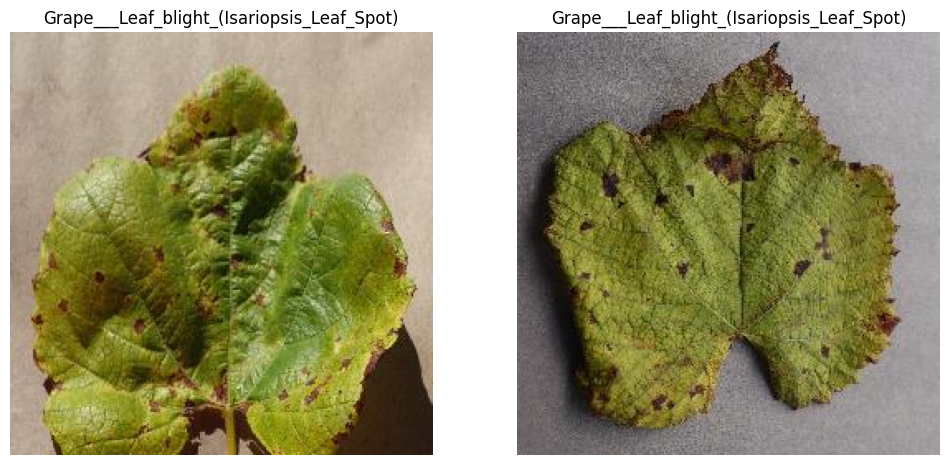

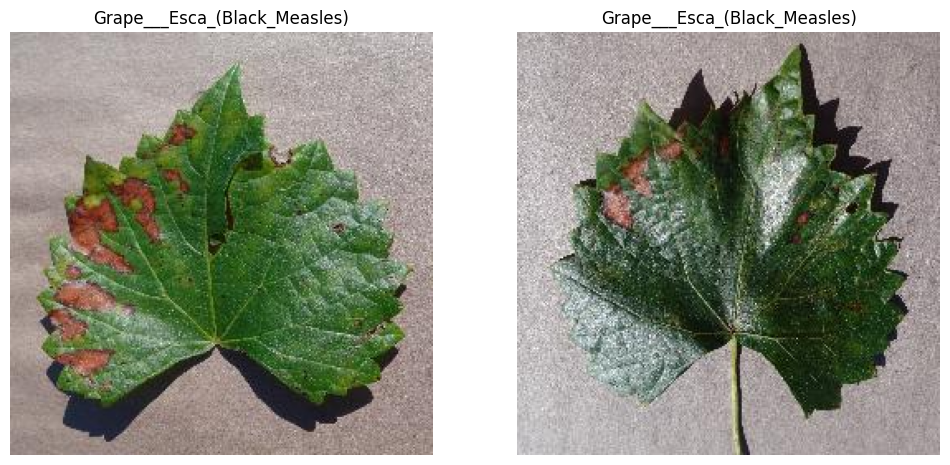

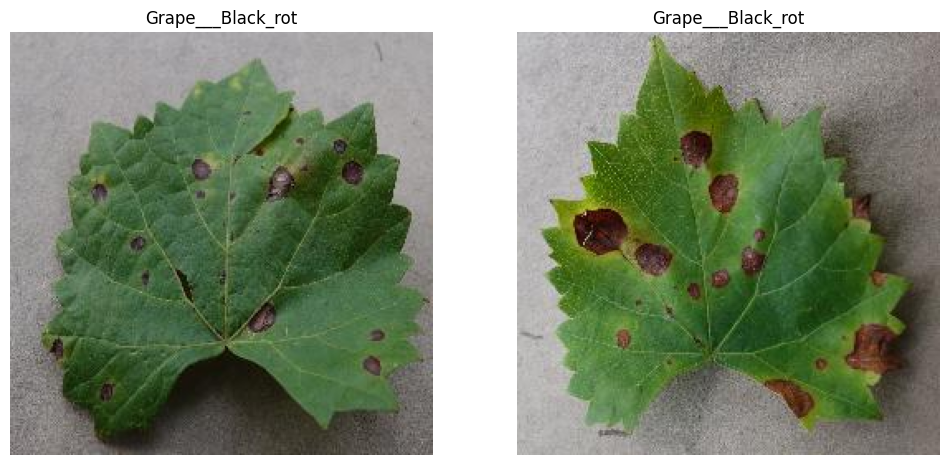

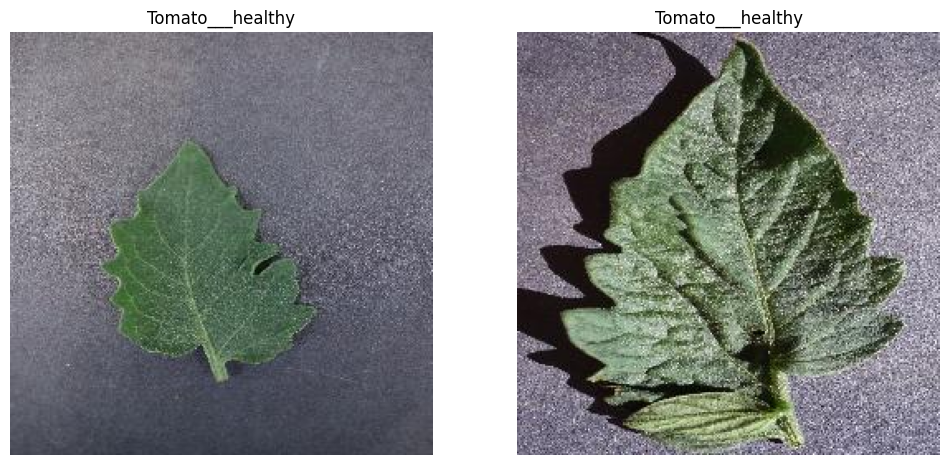

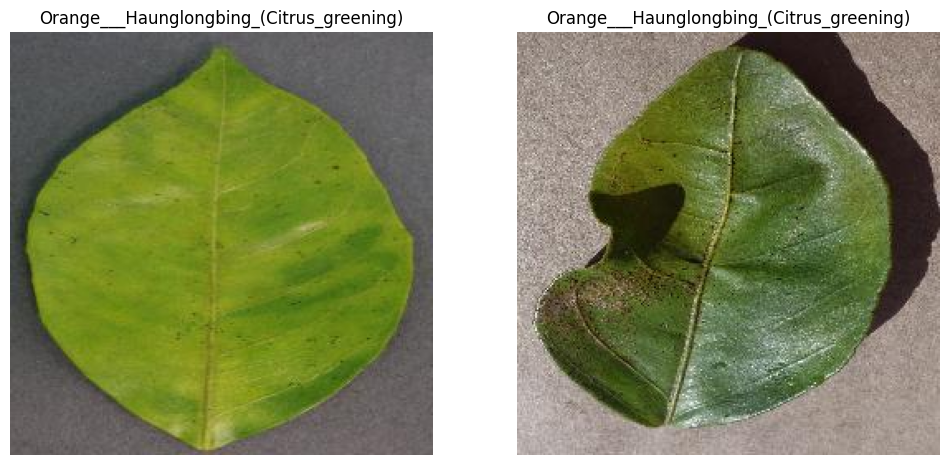

...

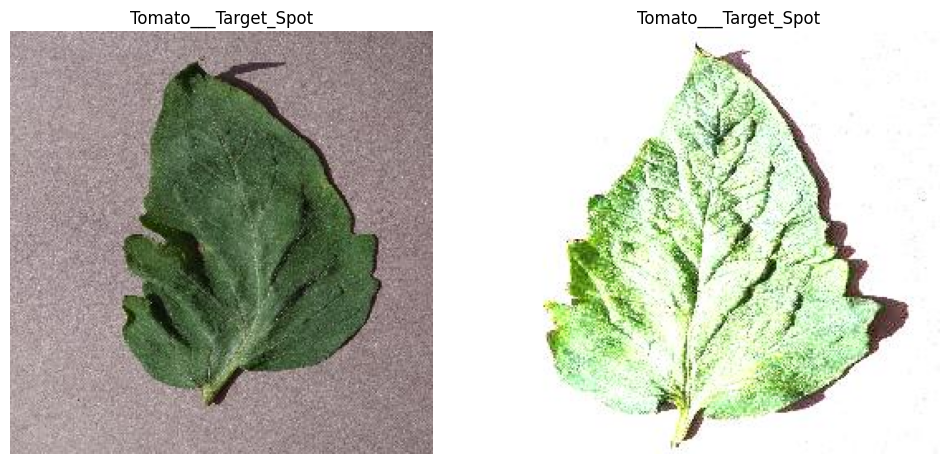

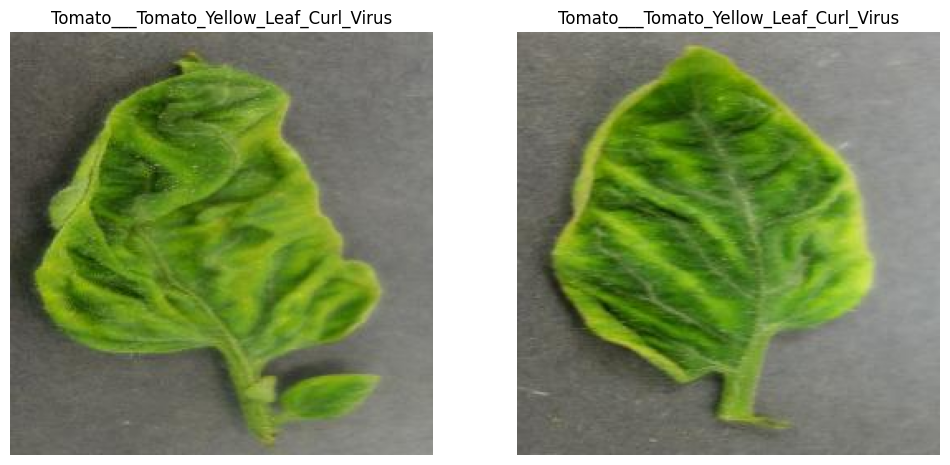

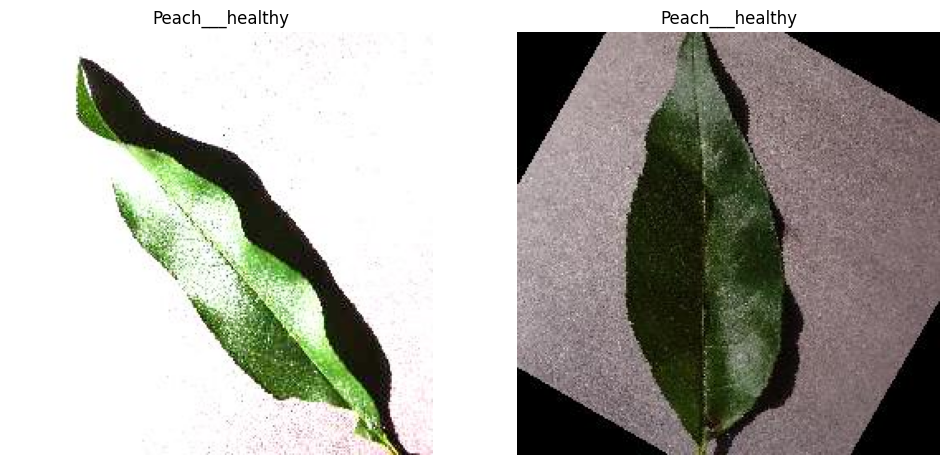

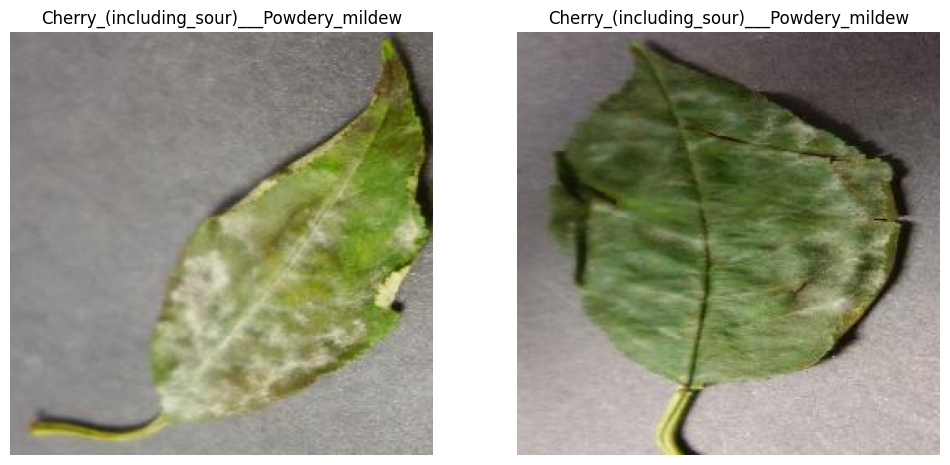

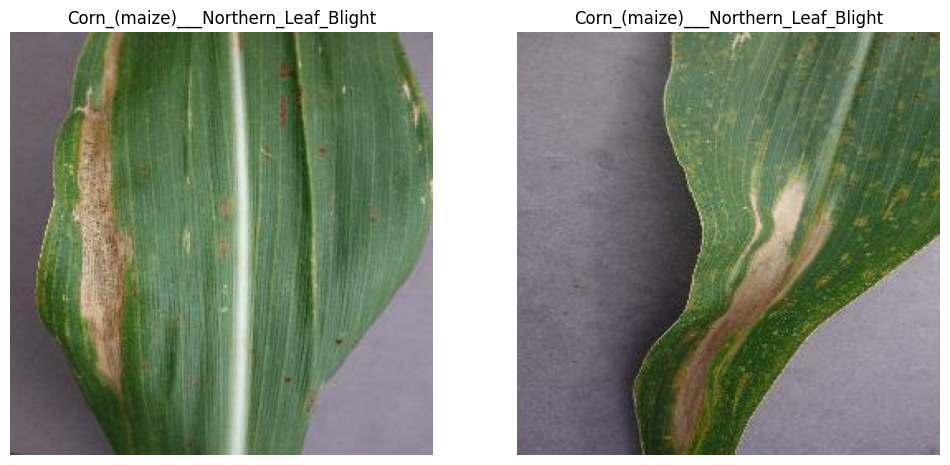

In [14]:
import matplotlib.pyplot as plt
import numpy as np
import os
from tensorflow.keras.preprocessing.image import load_img

def display_random_images(target_dir, num_images=2):
    for category in os.listdir(target_dir):
        if os.path.isdir(os.path.join(target_dir, category)):
            plt.figure(figsize=(12, 12))
            for i in range(num_images):
                plt.subplot(1, num_images, i + 1)
                file = np.random.choice(os.listdir(os.path.join(target_dir, category)))
                image_path = os.path.join(target_dir, category, file)
                image = load_img(image_path)
                plt.imshow(image)
                plt.title(category)
                plt.axis('off')
            plt.show()

display_random_images('/content/Plants/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train', num_images=2)

In [2]:
def preprocess_image_tensor(image, label, img_shape=224, scale=True):
    """
    Adjusts the given image tensor to the specified size and scales it if required.

    Parameters:
    - image: Image tensor.
    - label: Corresponding label for the image.
    - img_shape: Target size for each image. Default is 224.
    - scale: If True, scales pixel values to [0, 1].

    Returns:
    Tuple of (processed_image, label).
    """
    # Resize the image if it's not the expected size
    if image.shape[1] != img_shape or image.shape[2] != img_shape:
        image = tf.image.resize(image, [img_shape, img_shape])

    # Scale image to have pixel values between 0 and 1
    if scale:
        image /= 255.

    return image, label

In [8]:
import tensorflow as tf
from tensorflow.keras.preprocessing import image_dataset_from_directory

# Assuming you have separate directories for training and validation
train_dir = '/content/Plants/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train'
valid_dir = '/content/Plants/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/valid'

# Load the dataset
train_dataset = image_dataset_from_directory(train_dir,
                                             shuffle=True,
                                             batch_size=32,
                                             image_size=(224, 224),
                                             label_mode='categorical')

valid_dataset = image_dataset_from_directory(valid_dir,
                                             shuffle=True,
                                             batch_size=32,
                                             image_size=(224, 224),
                                             label_mode='categorical')

train_dataset = train_dataset.map(preprocess_image_tensor)
valid_dataset = valid_dataset.map(preprocess_image_tensor)

Found 70295 files belonging to 38 classes.
Found 17572 files belonging to 38 classes.


In [9]:
for images, labels in train_dataset.take(1):
    print(images.shape)

(32, 224, 224, 3)


In [37]:
import tensorflow as tf
from tensorflow.keras import regularizers

# Data augmentation
data_augmentation = tf.keras.Sequential([
  tf.keras.layers.experimental.preprocessing.RandomFlip("horizontal_and_vertical"),
  tf.keras.layers.experimental.preprocessing.RandomRotation(0.2),
  tf.keras.layers.experimental.preprocessing.RandomZoom(0.2),
])

# Import ResNet50V2 model without the top layer, pretrained on ImageNet
base_model = tf.keras.applications.efficientnet.EfficientNetB3(include_top= False, weights= "imagenet", input_shape= (224, 224, 3), pooling= 'max')

# Freeze the convolutional base to start
base_model.trainable = False

# Create the model
model = tf.keras.models.Sequential([
    data_augmentation,
    base_model,
    tf.keras.layers.BatchNormalization(axis= -1, momentum= 0.99, epsilon= 0.001),
    tf.keras.layers.Dense(256, kernel_regularizer= regularizers.l2(l= 0.016), activity_regularizer= regularizers.l1(0.006),
                bias_regularizer= regularizers.l1(0.006), activation= 'relu'),
    tf.keras.layers.Dropout(rate= 0.45, seed= 123),
    tf.keras.layers.Dense(38, activation= 'softmax')
])

model.compile(tf.keras.optimizers.Adamax(learning_rate= 0.001), loss= 'categorical_crossentropy', metrics= ['accuracy'])

In [45]:
import numpy as np

batch_size = 40  # Set batch size for training
epochs = 40  # Number of all epochs in training

train_samples = 70295  # Total number of training samples
validation_samples = 17572  # Total number of validation samples

# Calculate the number of batches per epoch for training and validation
steps_per_epoch = np.ceil(train_samples / batch_size)
validation_steps = np.ceil(validation_samples / batch_size)

# Learning rate scheduler callback
lr_scheduler = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.1,
    patience=2,
    min_lr=1e-6,
    mode='auto',
    verbose=1)

# Early stopping callback
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    patience=3,  # Number of epochs with no improvement after which training will be stopped
    restore_best_weights=True)


AttributeError: '_MapDataset' object has no attribute 'labels'

In [46]:
# Fit the model
history = model.fit(
    train_dataset,
    epochs=epochs,
    steps_per_epoch=steps_per_epoch,
    validation_data=valid_dataset,
    validation_steps=validation_steps,
    callbacks=[lr_scheduler, early_stopping])

Epoch 1/40
   6/2196 [..............................] - ETA: 3:03:49 - loss: 12.1348 - accuracy: 0.0365

KeyboardInterrupt: 

In [ ]:
model.evaluate(valid_dataset)